In [28]:
# Importación de paquetes
import numpy as np
import matplotlib.pyplot as plt
import sklearn
import sklearn.datasets
import sklearn.linear_model
import urllib.request  # Importa el módulo urllib
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
import tensorflow as tf
from tensorflow.keras.applications import VGG16
from tensorflow.keras import layers, models, optimizers
import random
%matplotlib inline

import tensorflow as tf

In [29]:
#Semillas para todas las librerías 
seed_value = 42
random.seed(seed_value)
np.random.seed(seed_value)

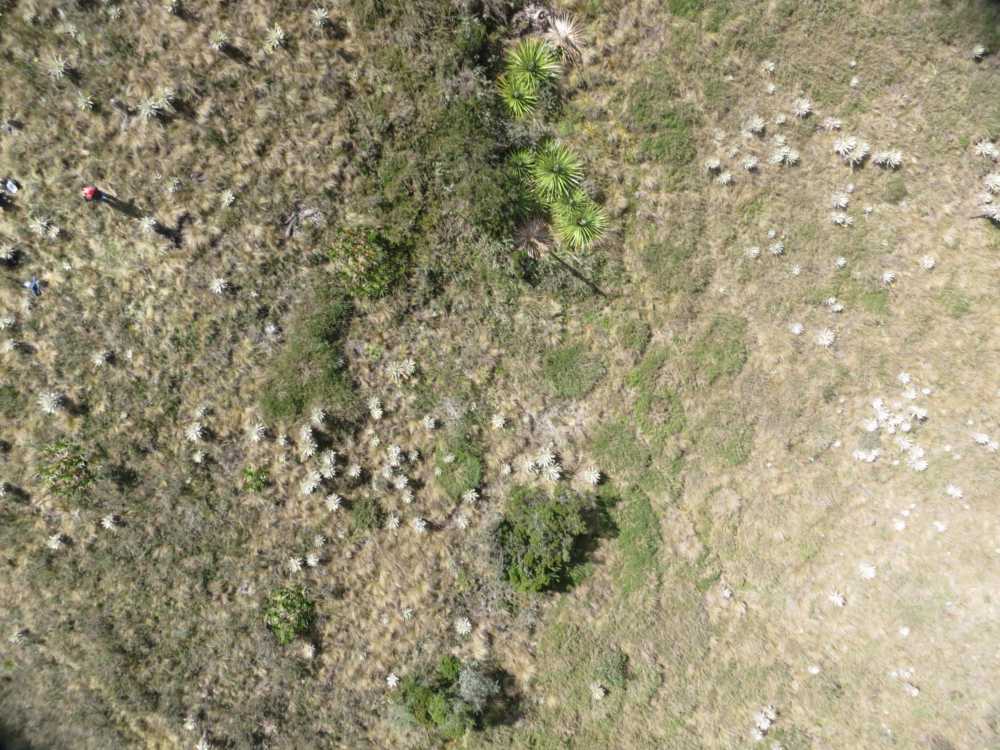

In [30]:
from tensorflow.keras.utils import load_img # import load_img from the correct module

urllib.request.urlretrieve('https://github.com/sergiomora03/AdvancedTopicsAnalytics/blob/main/notebooks/img/IMG_3451.JPG?raw=true', 'IMG_3451.JPG')
img = load_img('IMG_3451.JPG')
img

In [31]:
import urllib
from sklearn.model_selection import train_test_split
import numpy as np

# Descargar e importar el script de imágenes
urllib.request.urlretrieve(
    'https://raw.githubusercontent.com/sergiomora03/AdvancedTopicsAnalytics/main/notebooks/img/ImportImagenesURL.py',
    'ImportImagenes.py'
)

from ImportImagenes import import_imagenes

# Cargar los datos
X, Y = import_imagenes()

# Verifica la forma original de X y Y
print("Forma original de X:", X.shape)  # (14700, 250)
print("Forma original de Y:", Y.shape)  # (1, 250)

#  Y tenga la forma correcta como un vector de etiquetas (250,)
Y = Y.reshape(-1)  #  vector de tamaño (250,)

# Dividir los datos en conjuntos de entrenamiento y validación
CE_x, CV_x, CE_y, CV_y = train_test_split(X.T, Y, test_size=0.3, random_state=100)

# Verificar las formas después del ajuste
print("CE_x shape:", CE_x.shape)  # Debería ser (175, 14700) - 175 muestras de entrenamiento
print("CE_y shape:", CE_y.shape)  # Debería ser (175,) - 175 etiquetas de entrenamiento
print("CV_x shape:", CV_x.shape)  # Debería ser (75, 14700) - 75 muestras de validación
print("CV_y shape:", CV_y.shape)  # Debería ser (75,) - 75 etiquetas de validación

# Trasponer CE_x y CV_x para que coincidan con la forma original de X
CE_x = CE_x.T
CV_x = CV_x.T


Forma original de X: (14700, 250)
Forma original de Y: (1, 250)
CE_x shape: (175, 14700)
CE_y shape: (175,)
CV_x shape: (75, 14700)
CV_y shape: (75,)


# Red Convolucional con transferencia a VGG-16

## Sin Optuna

In [5]:
original_shape = int(np.sqrt(14700))  # Verifica si es un cuadrado perfecto
print(original_shape)
print(CE_x.shape, CV_x.shape, CE_y.shape, CV_y.shape)

121
(14700, 175) (14700, 75) (175,) (75,)


In [6]:
CE_x = CE_x.T
CV_x = CV_x.T
print(CE_x.shape, CV_x.shape, CE_y.shape, CV_y.shape)

(175, 14700) (75, 14700) (175,) (75,)


In [7]:
#CE_x_reshape = CE_x.reshape(-1, 70, 70, 1)
CE_x = CE_x.reshape(-1, 70, 70, 3)
CV_x = CV_x.reshape(-1, 70, 70, 3)
print(CE_x.shape, CV_x.shape)

(175, 70, 70, 3) (75, 70, 70, 3)


In [8]:
def preprocess_images(images, target_shape):
    
    reshaped_images = tf.image.resize(images, target_shape)
    return reshaped_images

# Redimensiona las imágenes a la forma que espera VGG16 (224, 224)
target_shape = (224, 224)
CE_x_redim = preprocess_images(CE_x, target_shape)
CV_x_redim = preprocess_images(CV_x, target_shape)

print(CE_x_redim.shape, CV_x_redim.shape)

(175, 224, 224, 3) (75, 224, 224, 3)


Modelamiento

In [8]:
#Verificacion de datos
print(CE_x_redim.shape)  # Debería ser (175, 224, 224, 3)
print(CV_x_redim.shape)  # Debería ser (n, 224, 224, 3)
print(CE_y.shape)       # Debería ser (175,)
print(CV_y.shape)       # Debería ser (n,)

(175, 224, 224, 3)
(75, 224, 224, 3)
(175,)
(75,)


In [9]:
import tensorflow as tf
from tensorflow.keras.applications import VGG16
from tensorflow.keras import layers, models, optimizers

tf.random.set_seed(42)

# Cargar VGG-16 sin la parte superior (top)
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Descongelar algunas capas del modelo base (las últimas 4 en este caso)
for layer in base_model.layers[:-4]:
    layer.trainable = False

# Agregar las nuevas capas superiores
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),  # Mejor que Flatten para evitar sobreajuste
    layers.Dense(512, activation='relu'),  # Capa adicional para mayor capacidad de aprendizaje
    layers.Dropout(0.5),  # Ajuste del Dropout
    layers.Dense(256, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(1, activation='sigmoid')  
])

# Compilar el modelo con una tasa de aprendizaje ajustada
model.compile(optimizer=optimizers.Adam(learning_rate=1e-4),  # Tasa de aprendizaje reducida
              loss='binary_crossentropy',
              metrics=[tf.keras.metrics.AUC(name='auc')])  # Usar AUC explícitamente

# Mostrar la arquitectura del modelo
model.summary()


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ vgg16 (Functional)              │ (None, 7, 7, 512)      │    14,714,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 512)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 512)            │       262,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 15,108,929 (57.64 MB)

 Trainable params: 7,473,665 (28.51 MB)

 Non-trainable params: 7,635,264 (29.13 MB)

In [10]:
history = model.fit(CE_x_redim,CE_y, epochs=10, validation_data=(CV_x_redim,CV_y,), batch_size=32)

Epoch 1/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 24s 4s/step - auc: 0.4965 - loss: 0.7357 - val_auc: 0.7852 - val_loss: 0.6627
Epoch 2/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 23s 4s/step - auc: 0.4970 - loss: 0.7402 - val_auc: 0.8383 - val_loss: 0.6237
Epoch 3/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 23s 4s/step - auc: 0.6281 - loss: 0.6623 - val_auc: 0.8823 - val_loss: 0.5491
Epoch 4/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 23s 4s/step - auc: 0.7908 - loss: 0.5506 - val_auc: 0.9164 - val_loss: 0.4457
Epoch 5/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 23s 4s/step - auc: 0.7843 - loss: 0.5474 - val_auc: 0.9491 - val_loss: 0.3379
Epoch 6/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 24s 4s/step - auc: 0.8637 - loss: 0.4437 - val_auc: 0.9706 - val_loss: 0.3226
Epoch 7/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 24s 4s/step - auc: 0.9233 - loss: 0.3732 - val_auc: 0.9724 - val_loss: 0.2412
Epoch 8/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 25s 4s/step - auc: 0.9737 - loss: 0.2355 - val_auc: 0.9851 - val_loss: 0.1593
Epoch 9/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 25s 4s/step - auc: 0.9869 - loss: 0.1581 - val_auc: 

In [11]:
loss, auc = model.evaluate(CV_x_redim, CV_y)
print(f'Pérdida: {loss:.4f}')
#print(f'Precisión: {accuracy:.4f}')
print(f'AUC: {auc:.4f}')

3/3 ━━━━━━━━━━━━━━━━━━━━ 6s 2s/step - auc: 0.9899 - loss: 0.0990
Pérdida: 0.0990
AUC: 0.9920


## Análisis cualitativo

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 

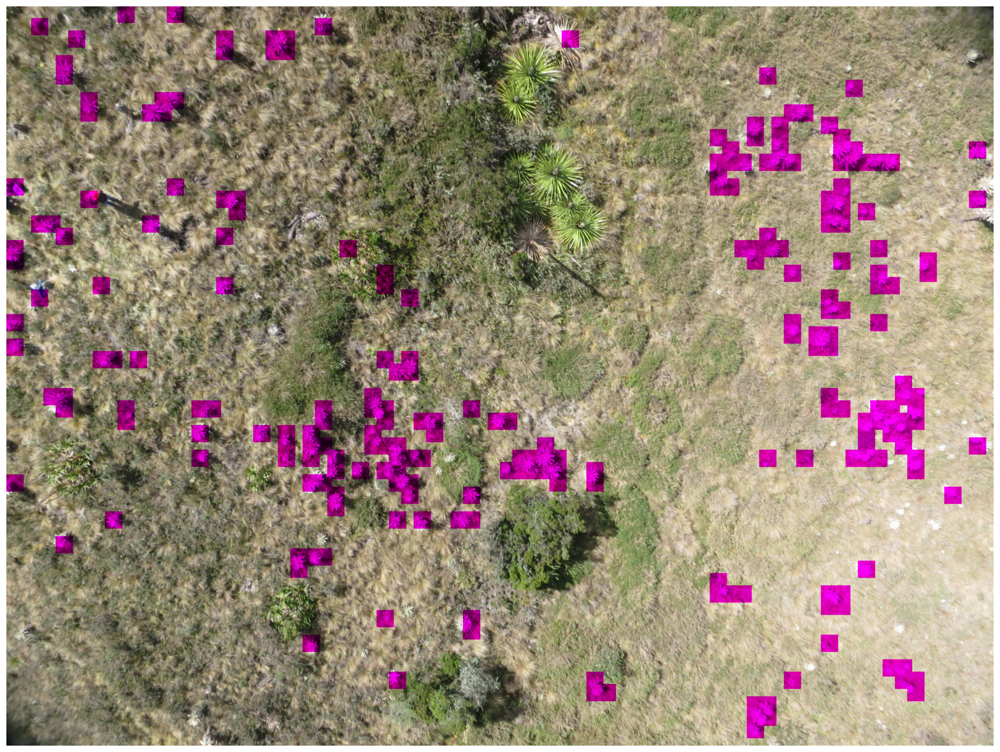

242


In [12]:
import numpy as np
import matplotlib.pyplot as plt
 
# Convertir la imagen a un arreglo de NumPy
x = np.array(img, dtype=np.float32) / 255.0 
x2 = x.copy()  # Copia de la imagen original para modificarla
 
# Definir el tamaño de los parches
patch_size = 70
step_size = 50
 
# Obtener las dimensiones de la imagen
ni = x.shape[0] - patch_size + 1  # Añadido +1 para incluir el último parche
mi = x.shape[1] - patch_size + 1  # Añadido +1 para incluir el último parche

cont1=0
# Iterar sobre la imagen en pasos de `step_size`
for f1 in range(0, ni, step_size):
    for c1 in range(0, mi, step_size):
        # Definir el parche
        f2 = min(f1 + patch_size, x.shape[0])  # Asegurarse de no superar los límites
        c2 = min(c1 + patch_size, x.shape[1])  # Asegurarse de no superar los límites
        subi = x[f1:f2, c1:c2, :]

        # Asegúrate de que el parche tenga la forma (1, 70, 70, 3) para el modelo
        subi_reshaped = subi.reshape(1, patch_size, patch_size, 3)

        # Preprocesar el parche (normalización y ajuste específico para VGG16)
        subi_preprocessed = preprocess_images(subi_reshaped,(224, 224))

        # Hacer la predicción usando el modelo entrenado
        pred_P = model.predict(subi_preprocessed)

        # Convertir la predicción a 0 o 1 (asumiendo una clasificación binaria)
        pred_P = (pred_P > 0.5).astype(int)

        # Si la predicción es 1, modifica el canal de color en la imagen
        if pred_P[0] == 1:
            cont1= cont1 + 1
            # Cambiar el canal verde a 0 para marcar en rojo
            x2[f1:f2, c1:c2, 1] = 0  # Pinta de rojo en lugar de amarillo 
                  

# Mostrar la imagen modificada
plt.figure(figsize=(20, 20))
plt.imshow(x2)
plt.axis('off')  # Opcional: quitar los ejes
plt.show()

print(cont1)

## Con Hiperparámetros de Optuna

In [ ]:
import optuna
from tensorflow.keras import layers, models
tf.random.set_seed(58) 
 
# Definir el objetivo de optimización
def objective(trial):
    

    # Sugerir valores para los hiperparámetros
    learning_rate = trial.suggest_float('learning_rate', 1e-4, 1e-3, log=True)
    units = trial.suggest_int('units', 64, 512, step=64)
    dropout_rate = trial.suggest_float('dropout_rate', 0.2, 0.5)

    # Cargar VGG-16 sin la parte superior (top)
    base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

    # Descongelar algunas capas del modelo base (las últimas 4 en este caso)
    for layer in base_model.layers[:-4]:
        layer.trainable = False

    # Agregar las nuevas capas superiores
    model = models.Sequential([
        base_model,
        layers.GlobalAveragePooling2D(),  # Mejor que Flatten para evitar sobreajuste
        layers.Dense(512, activation='relu'),  # Capa adicional para mayor capacidad de aprendizaje
        layers.Dropout(0.5), 
        layers.Dense(256, activation='relu'),
        layers.Dropout(0.5),
        layers.Dense(1, activation='sigmoid')  
    ])

    # Compilar el modelo con los hiperparámetros sugeridos
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
                  loss='binary_crossentropy',
                  metrics=['auc'])

    # Suponiendo que tienes conjuntos de datos de entrenamiento y validación
    history = model.fit(CE_x_redim, CE_y, 
                        epochs=10, 
                        validation_data=(CV_x_redim, CV_y), 
                        verbose=0)

    # Obtener la mejor métrica AUC en la validación
    auc = max(history.history['val_auc'])

    return auc

# Crear un estudio de Optuna y optimizarlo
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=10)

# Mejor hiperparámetro encontrado
print("Mejor conjunto de hiperparámetros:", study.best_trial.params)

In [20]:
tf.random.set_seed(50)  

base_model2 = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

for layer in base_model2.layers[:-4]:
    layer.trainable = False

model2 = models.Sequential([
    base_model2,
    layers.GlobalAveragePooling2D(), 
    layers.Dense(128, activation='relu'),  
    layers.Dropout(0.2291),  
    #layers.Dense(128, activation='relu'),
    #layers.Dropout(0.2291),
    layers.Dense(1, activation='sigmoid')  
])

model2.compile(optimizer=optimizers.Adam(learning_rate=0.0007289),
              loss='binary_crossentropy',
              metrics=[tf.keras.metrics.AUC(name='auc'),'accuracy'])

model2.summary()

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ vgg16 (Functional)              │ (None, 7, 7, 512)      │    14,714,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_4      │ (None, 512)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 128)            │        65,664 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_8 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,780,481 (56.38 MB)

 Trainable params: 7,145,217 (27.26 MB)

 Non-trainable params: 7,635,264 (29.13 MB)

In [24]:
history = model2.fit(CE_x_redim,CE_y, epochs=32, validation_data=(CV_x_redim,CV_y,), batch_size=32)

Epoch 1/32
6/6 ━━━━━━━━━━━━━━━━━━━━ 22s 4s/step - accuracy: 1.0000 - auc: 1.0000 - loss: 9.2188e-06 - val_accuracy: 0.9867 - val_auc: 1.0000 - val_loss: 0.0413
Epoch 2/32
6/6 ━━━━━━━━━━━━━━━━━━━━ 22s 4s/step - accuracy: 1.0000 - auc: 1.0000 - loss: 8.4916e-06 - val_accuracy: 0.9867 - val_auc: 1.0000 - val_loss: 0.0489
Epoch 3/32
6/6 ━━━━━━━━━━━━━━━━━━━━ 23s 4s/step - accuracy: 1.0000 - auc: 1.0000 - loss: 6.9668e-06 - val_accuracy: 0.9867 - val_auc: 1.0000 - val_loss: 0.0500
Epoch 4/32
6/6 ━━━━━━━━━━━━━━━━━━━━ 24s 4s/step - accuracy: 1.0000 - auc: 1.0000 - loss: 5.1836e-06 - val_accuracy: 0.9867 - val_auc: 1.0000 - val_loss: 0.0523
Epoch 5/32
6/6 ━━━━━━━━━━━━━━━━━━━━ 32s 6s/step - accuracy: 1.0000 - auc: 1.0000 - loss: 1.7296e-06 - val_accuracy: 0.9867 - val_auc: 1.0000 - val_loss: 0.0530
Epoch 6/32
6/6 ━━━━━━━━━━━━━━━━━━━━ 29s 5s/step - accuracy: 1.0000 - auc: 1.0000 - loss: 2.4708e-06 - val_accuracy: 0.9867 - val_auc: 1.0000 - val_loss: 0.0491
Epoch 7/32
6/6 ━━━━━━━━━━━━━━━━━━━━ 27s 

In [25]:
loss,accuracy, auc = model2.evaluate(CV_x_redim, CV_y)
print(f'Pérdida: {loss:.2f}')
print(f'Precisión: {accuracy:.4f}')
print(f'AUC: {auc:.2f}')

3/3 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.9933 - auc: 1.0000 - loss: 0.0197
Pérdida: 0.04
Precisión: 1.0000
AUC: 0.99


## Análisis cualitativo

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

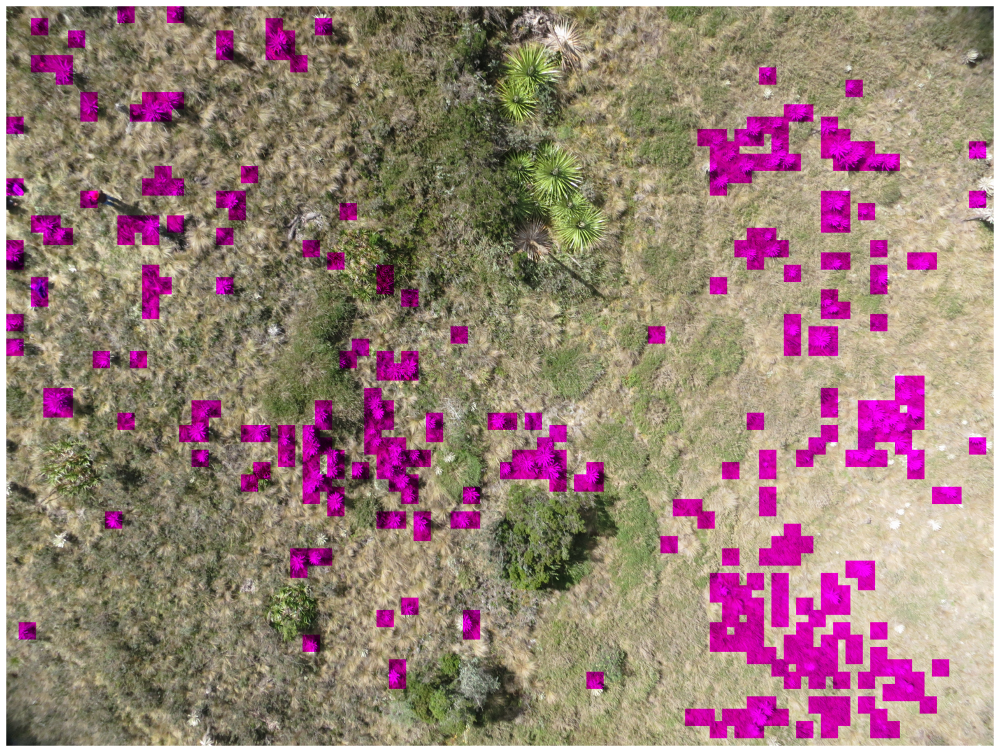

380


In [32]:
# Convertir la imagen a un arreglo de NumPy
x = np.array(img, dtype=np.float32) / 255.0 
x2 = x.copy()  # Copia de la imagen original para modificarla
 
# Definir el tamaño de los parches
patch_size = 70
step_size = 50
 
# Obtener las dimensiones de la imagen
ni = x.shape[0] - patch_size + 1  # Añadido +1 para incluir el último parche
mi = x.shape[1] - patch_size + 1  # Añadido +1 para incluir el último parche

cont=0
# Iterar sobre la imagen en pasos de `step_size`
for f1 in range(0, ni, step_size):
    for c1 in range(0, mi, step_size):
        # Definir el parche
        f2 = min(f1 + patch_size, x.shape[0])  # Asegurarse de no superar los límites
        c2 = min(c1 + patch_size, x.shape[1])  # Asegurarse de no superar los límites
        subi = x[f1:f2, c1:c2, :]

        # Asegúrate de que el parche tenga la forma (1, 70, 70, 3) para el modelo
        subi_reshaped = subi.reshape(1, patch_size, patch_size, 3)

        # Preprocesar el parche (normalización y ajuste específico para VGG16)
        subi_preprocessed = preprocess_images(subi_reshaped,(224, 224))

        # Hacer la predicción usando el modelo entrenado
        pred_P = model2.predict(subi_preprocessed)

        # Convertir la predicción a 0 o 1 (asumiendo una clasificación binaria)
        pred_P = (pred_P > 0.5).astype(int)

        # Si la predicción es 1, modifica el canal de color en la imagen
        if pred_P[0] == 1:
            cont= cont + 1
            # Cambiar el canal verde a 0 para marcar en rojo
            x2[f1:f2, c1:c2, 1] = 0  # Pinta de rojo en lugar de amarillo 
                  

# Mostrar la imagen modificada
plt.figure(figsize=(20, 20))
plt.imshow(x2)
plt.axis('off')  # Opcional: quitar los ejes
plt.show()

print(cont)

## Densidad poblacional

In [ ]:
#Total de puntos generados sobre la imagen = 343
ancho,alto = img.size
# Mostrar las dimensiones
print(f"Dimensiones de la imagen: {ancho}x{alto} píxeles")

Dimensiones de la imagen: 4000x3000 píxeles


In [ ]:
Densidad = cont/(ancho*alto)
print(f"Densidad poblacional total sobre la imagen es de: {Densidad} frailejones/pixeles²")

Densidad poblacional total sobre la imagen es de: 2.8583333333333335e-05 frailejones/pixeles²


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 1

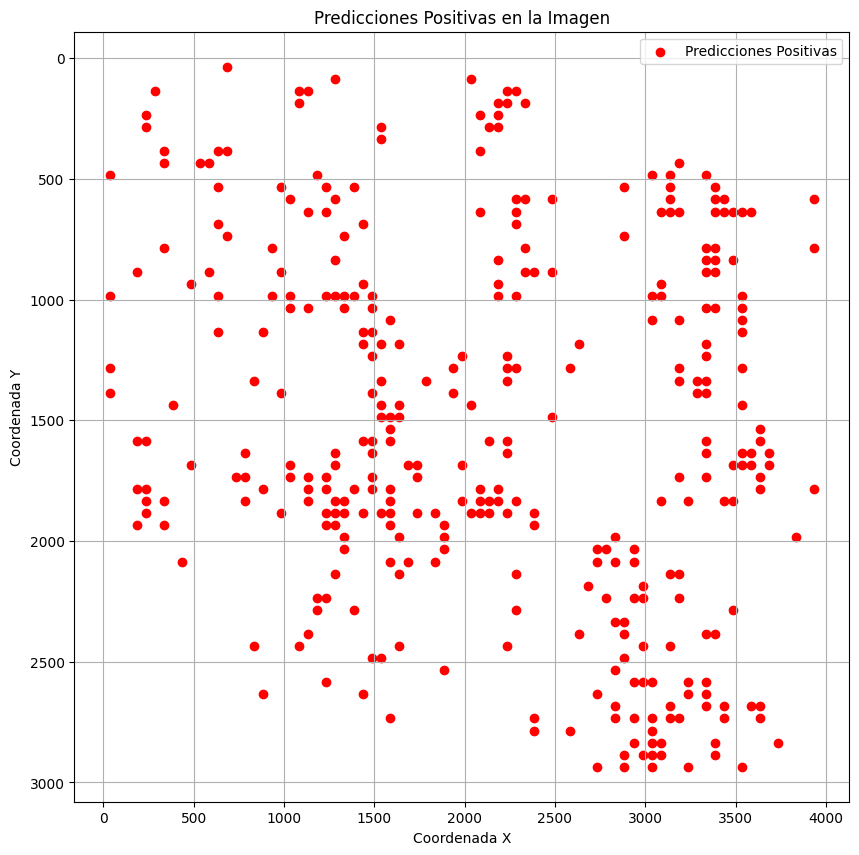

343


In [ ]:
# Convertir la imagen a un arreglo de NumPy
x = np.array(img, dtype=np.float32) / 255.0

# Definir el tamaño de los parches
patch_size = 70
step_size = 50

# Obtener las dimensiones de la imagen
ni = x.shape[0] - patch_size + 1
mi = x.shape[1] - patch_size + 1

# Lista para almacenar las coordenadas de los parches con predicción positiva
pred_positive_coords = []

# Iterar sobre la imagen en pasos de `step_size`
for f1 in range(0, ni, step_size):
    for c1 in range(0, mi, step_size):
        # Definir el parche
        f2 = min(f1 + patch_size, x.shape[0])
        c2 = min(c1 + patch_size, x.shape[1])
        subi = x[f1:f2, c1:c2, :]

        # Asegúrate de que el parche tenga la forma (1, 70, 70, 3) para el modelo
        subi_reshaped = subi.reshape(1, patch_size, patch_size, 3)

        # Preprocesar el parche (normalización y ajuste específico para VGG16)
        subi_preprocessed = preprocess_images(subi_reshaped, (224, 224))

        # Hacer la predicción usando el modelo entrenado
        pred_P = model.predict(subi_preprocessed)

        # Convertir la predicción a 0 o 1 (asumiendo una clasificación binaria)
        pred_P = (pred_P > 0.5).astype(int)

        # Si la predicción es 1, guardar las coordenadas del parche
        if pred_P[0] == 1:
            pred_positive_coords.append((c1 + patch_size // 2, f1 + patch_size // 2))

# Convertir la lista de coordenadas a un arreglo NumPy para facilitar la manipulación
pred_positive_coords = np.array(pred_positive_coords)

# Mostrar las predicciones en un gráfico de dispersión
plt.figure(figsize=(10, 10))
plt.scatter(pred_positive_coords[:, 0], pred_positive_coords[:, 1], color='red', marker='o', label='Predicciones Positivas')
plt.gca().invert_yaxis()  # Invertir el eje y para que coincida con la orientación de la imagen
plt.xlabel('Coordenada X')
plt.ylabel('Coordenada Y')
plt.title('Predicciones Positivas en la Imagen')
plt.legend()
plt.grid(True)
plt.show()

# Imprimir el número de predicciones positivas
print(len(pred_positive_coords))


# Densidad por clases (GMM)

In [ ]:
print(f"x_coords: {pred_positive_coords}")

x_coords: [[ 685   35]
 [1285   85]
 [2035   85]
 [ 285  135]
 [1085  135]
 [1135  135]
 [2235  135]
 [2285  135]
 [1085  185]
 [2185  185]
 [2235  185]
 [2335  185]
 [ 235  235]
 [2085  235]
 [2185  235]
 [ 235  285]
 [1535  285]
 [2135  285]
 [2185  285]
 [1535  335]
 [ 335  385]
 [ 635  385]
 [ 685  385]
 [2085  385]
 [ 335  435]
 [ 535  435]
 [ 585  435]
 [3185  435]
 [  35  485]
 [1185  485]
 [3035  485]
 [3135  485]
 [3335  485]
 [ 635  535]
 [ 985  535]
 [1235  535]
 [1385  535]
 [2885  535]
 [3135  535]
 [3385  535]
 [1035  585]
 [1285  585]
 [2285  585]
 [2335  585]
 [2485  585]
 [3135  585]
 [3385  585]
 [3435  585]
 [3935  585]
 [1135  635]
 [1235  635]
 [2085  635]
 [2285  635]
 [3085  635]
 [3135  635]
 [3185  635]
 [3385  635]
 [3435  635]
 [3485  635]
 [3535  635]
 [3585  635]
 [ 635  685]
 [1435  685]
 [2285  685]
 [ 685  735]
 [1335  735]
 [2885  735]
 [ 335  785]
 [ 935  785]
 [2335  785]
 [3335  785]
 [3385  785]
 [3935  785]
 [1285  835]
 [2185  835]
 [3335  835]
 [

In [ ]:
from sklearn.mixture import GaussianMixture
import numpy as np

# Definir el número de componentes (número de clusters)
n_components = 4  # Este número puede ajustarse según la cantidad de grupos esperados

# Crear y ajustar el modelo GMM
gmm = GaussianMixture(n_components=n_components, random_state=42)
gmm.fit(pred_positive_coords)

# Predecir los clusters
labels = gmm.predict(pred_positive_coords)


In [ ]:
from scipy.spatial import ConvexHull

# Calcular la densidad para cada cluster
densities = []
for i in range(n_components):
    # Filtrar puntos pertenecientes al cluster i
    cluster_points = pred_positive_coords[labels == i]
    
    # Calcular el área del grupo usando el Convex Hull (envoltura convexa)
    hull = ConvexHull(cluster_points)
    area = hull.volume  # El volumen en 2D es equivalente al área

    # Calcular densidad
    density = len(cluster_points) / area
    densities.append(density)

# Mostrar las densidades
for i, density in enumerate(densities):
    print(f"Densidad del grupo {i + 1}: {density:.6f} frailejones por unidad de área")


Densidad del grupo 1: 0.000047 frailejones por unidad de área
Densidad del grupo 2: 0.000049 frailejones por unidad de área
Densidad del grupo 3: 0.000032 frailejones por unidad de área
Densidad del grupo 4: 0.000056 frailejones por unidad de área


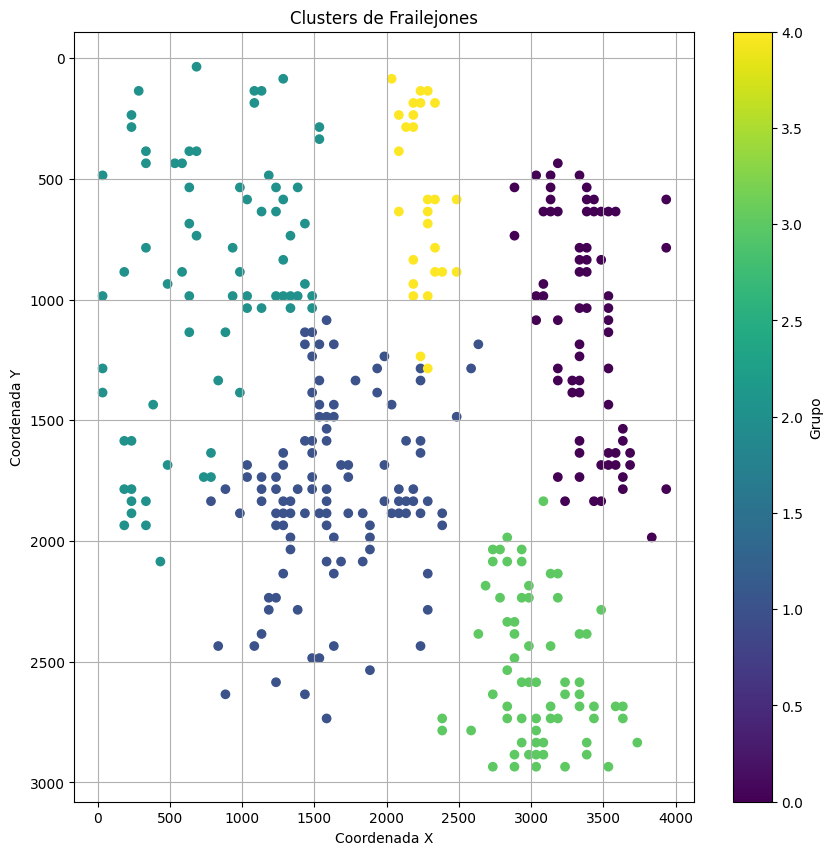

In [ ]:
# Visualizar los clusters
plt.figure(figsize=(10, 10))
plt.scatter(pred_positive_coords[:, 0], pred_positive_coords[:, 1], c=labels, cmap='viridis', marker='o')
plt.gca().invert_yaxis()  # Invertir el eje y para que coincida con la orientación de la imagen
plt.xlabel('Coordenada X')
plt.ylabel('Coordenada Y')
plt.title('Clusters de Frailejones')
plt.colorbar(label='Grupo')
plt.grid(True)
plt.show()


In [ ]:
print(pred_positive_coords.dtype)

int32


## Identificando la mejor cantidad de componentes

In [ ]:
import h5py
import numpy as np

# Ruta al archivo HDF5
file_path = r"D:\Maestría\Analitica 3\GitHub Javeriana\Topicos_Avanzados_Analitica_LESDR\P0_BigMonksDetection (Proyecto)\data_F"

with h5py.File(file_path, 'r') as f:
    # Asegúrate de que estás extrayendo un dataset numérico
    Data = np.array(f['Frailejon'])  # Ajusta el nombre del dataset según sea necesario

# Verifica el tipo de datos
print(Data.dtype)

uint8


In [ ]:
Data.shape

(21, 100, 100, 3)

In [ ]:
#Reformateo de datos
# Suponiendo que Data tiene la forma (21, 100, 100, 3)
n_samples = Data.shape[0]  # 21
image_size = Data.shape[1] * Data.shape[2] * Data.shape[3]  # 100 * 100 * 3 = 30000

# Reformatear Data a una matriz 2D de tamaño (21, 30000)
Data_reshaped = Data.reshape(n_samples, image_size)
    

In [ ]:
from sklearn.decomposition import PCA

# Definir el número de componentes principales que deseas conservar
n_components_pca = 21  # Puedes ajustar este número

# Aplicar PCA a los datos para reducir la dimensionalidad
pca = PCA(n_components=n_components_pca)
Data_pca = pca.fit_transform(Data_reshaped)


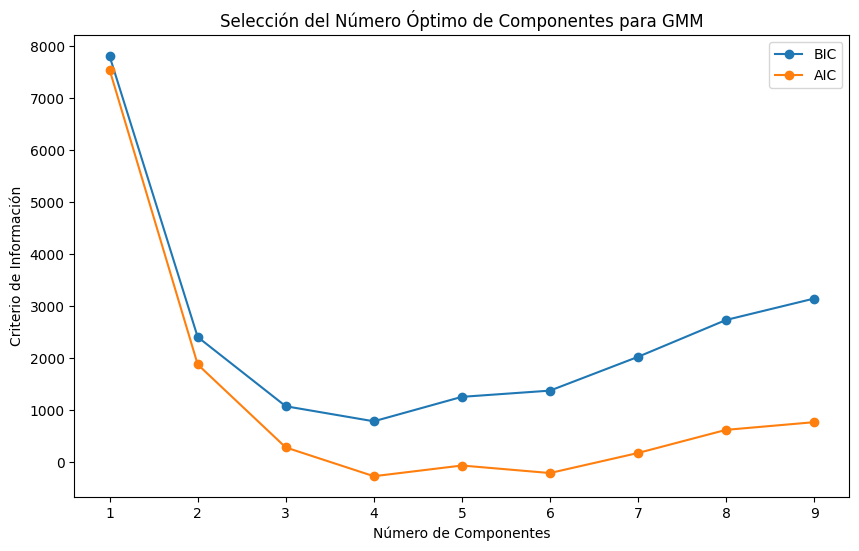

In [ ]:
from sklearn.mixture import GaussianMixture
import matplotlib.pyplot as plt

# Definir el rango de componentes a probar
n_components_range = range(1, 10)

# Listas para almacenar los valores de BIC y AIC
bics = []
aics = []

for n_components in n_components_range:
    # Ajustar el modelo GMM
    gmm = GaussianMixture(n_components=n_components, random_state=42)
    gmm.fit(Data_pca)
    
    # Calcular BIC y AIC
    bics.append(gmm.bic(Data_pca))
    aics.append(gmm.aic(Data_pca))

# Graficar BIC y AIC
plt.figure(figsize=(10, 6))
plt.plot(n_components_range, bics, label='BIC', marker='o')
plt.plot(n_components_range, aics, label='AIC', marker='o')
plt.xlabel('Número de Componentes')
plt.ylabel('Criterio de Información')
plt.title('Selección del Número Óptimo de Componentes para GMM')
plt.legend()
plt.show()


Probar diferentes números de componentes

In [ ]:
# Encontrar el número óptimo de componentes
best_n_components_bic = n_components_range[np.argmin(bics)]
best_n_components_aic = n_components_range[np.argmin(aics)]

print(f"Mejor número de componentes según BIC: {best_n_components_bic}")
print(f"Mejor número de componentes según AIC: {best_n_components_aic}")

Mejor número de componentes según BIC: 4
Mejor número de componentes según AIC: 4


In [ ]:
# Ajustar el modelo GMM con el número óptimo de componentes
best_n_components = best_n_components_bic  # o usa `best_n_components_aic`
gmm = GaussianMixture(n_components=best_n_components, random_state=42)
gmm.fit(Data_pca)

GaussianMixture(n_components=4, random_state=42)